# <center>**Fruit Detection**</center>

###**Introduction**

In this notebook, we will present our dataset as well as the actions we took to prepare it for training object identification models.

###**Outline**


1.   Data Collection
2.   Data Preparation


###**1. Data Collection**

install libraries

In [ ]:
! pip install pylabel
! pip install pybboxes
! pip install bounding_box
! pip install pycocotools
! pip install layoutparser
! pip install seedir
! pip install emoji

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 367 kB 48.3 MB/s 
     |████████████████████████████████| 1.6 MB 58.7 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 164 kB 29.0 MB/s 
  Created wheel for bounding-box: filename=bounding_box-0.1.3-py3-none-any.whl size=163934 sha256=ba2261329979a45a03438e3ce7a326216a6aed4c9e73229ca5e1e81bcdd8d0a1
  Stored in directory: /root/.cache/pip/wheels/d0/68/52/620d95111c8b9af2612f0150c3f1b85008f48edb543e197924
Successfully built bounding-box
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |███████████████████████

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 111 kB 36.1 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 240 kB 29.0 MB/s 
  Created wheel for emoji: filename=emoji-2.2.0-py3-none-any.whl size=234926 sha256=4b5b8a7bdffb20936a4937d8faea94b52478e595f21d48d8cf5c663fdb8b9838
  Stored in directory: /root/.cache/pip/wheels/86/62/9e/a6b27a681abcde69970dbc0326ff51955f3beac72f15696984
Successfully built emoji


import libraries

In [ ]:
import os
import tarfile
import shutil
from zipfile import ZipFile
from IPython.display import Image, display
import cv2
import fnmatch
from pathlib import Path

For our project, we collected dataset from kaggle, github and Roboflow-datasets

In [ ]:
# using drive to load the data
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.chdir("/content")
os.mkdir("/content/fruits")
os.mkdir("/content/fruits/apple")
os.mkdir("/content/fruits/avocado")
os.mkdir("/content/fruits/cherry")
os.mkdir("/content/fruits/orange")
os.mkdir("/content/fruits/strawberry")
#os.mkdir("/content/fruits/peach")
os.mkdir("/content/fruits/grape")

In [ ]:
os.chdir("/content/drive/MyDrive/4IA_project/fruits")  # Change directory to Project_directory stored in drive

In [ ]:
! ls

apple.tar			notebooks
apple_trees_farm_annotated.mp4	orange.tar
apple_trees_farm.mp4		orange_tree_farm_annotated.mp4
avocado.tar			orange_tree_farm.mp4
cherry.tar			peach.zip
cherry_tree_farm.mp4		strawberry.zip
dataset				yolov5
grapes.zip


Our dataset contains 5 classes of fruits as follows :


*   apple
*   avocado
*   cherry
*   orange
*   strawberry
*   grapes

We collected these datasets from, Kaggle, github and Roboflow datasets.


extract the annotated images from .zip and .tar files

In [ ]:
def extract_tar(file_name,directory_name):
  my_tar = tarfile.open(file_name)
  my_tar.extractall(directory_name)
  my_tar.close()

In [ ]:
extract_tar('apple.tar', '/content/fruits/apple')
extract_tar('avocado.tar', '/content/fruits/avocado')
extract_tar('cherry.tar', '/content/fruits/cherry')
extract_tar('orange.tar', '/content/fruits/orange')

In [ ]:
def extract_csv(filename, directory_name):
  with ZipFile(filename, 'r') as zipObj:
    # Extract all the contents of zip file in different directory
    zipObj.extractall(directory_name)

In [ ]:
extract_csv('strawberry.zip', '/content/fruits/strawberry')
#extract_csv('peach.zip', '/content/fruits/peach')
extract_csv('grapes.zip', '/content/fruits/grape')

In [ ]:
# strawberry labels
os.mkdir("/content/fruits/strawberry/train_labels")
os.mkdir("/content/fruits/strawberry/test_labels")
os.mkdir("/content/fruits/strawberry/valid_labels")

In [ ]:
# peach labels
"""os.mkdir("/content/fruits/peach/train_labels")
os.mkdir("/content/fruits/peach/test_labels")
os.mkdir("/content/fruits/peach/valid_labels")"""

'os.mkdir("/content/fruits/peach/train_labels")\nos.mkdir("/content/fruits/peach/test_labels")\nos.mkdir("/content/fruits/peach/valid_labels")'

In [ ]:
os.chdir("/content")

###**2. Data Preparation**

For the Data preparation, so we used roboflow framework to annotate images.

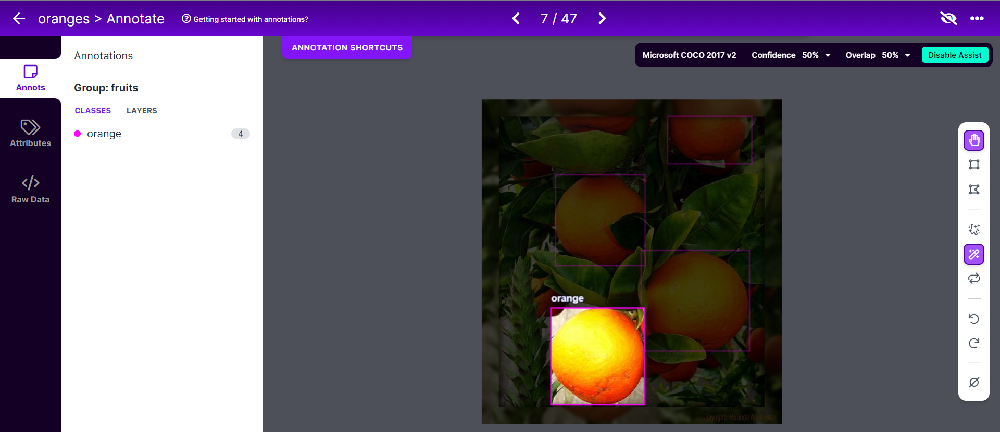

In [ ]:
Image("/content/drive/MyDrive/4IA_project/roboflow.PNG")

we converted data annotations from coco to yolo format

In [ ]:
from pylabel import importer

In [ ]:
def Json_to_Yolo(path_to_annotations, path_to_images, path_converted_annotations):
  dataset = importer.ImportCoco(path_to_annotations, path_to_images=path_to_images, name="BCCD_coco")
  os.chdir(path_converted_annotations)
  dataset.path_to_annotations = path_converted_annotations
  dataset.export.ExportToYoloV5()[0]
  os.chdir("/content")

In [ ]:
# strawberry
Json_to_Yolo("/content/fruits/strawberry/train/_annotations.coco.json", "/content/fruits/strawberry/train", "/content/fruits/strawberry/train_labels")
Json_to_Yolo("/content/fruits/strawberry/test/_annotations.coco.json", "/content/fruits/strawberry/test", "/content/fruits/strawberry/test_labels")
Json_to_Yolo("/content/fruits/strawberry/valid/_annotations.coco.json", "/content/fruits/strawberry/valid", "/content/fruits/strawberry/valid_labels")

# peach
"""Json_to_Yolo("/content/fruits/peach/train/_annotations.coco.json", "/content/fruits/peach/train", "/content/fruits/peach/train_labels")
Json_to_Yolo("/content/fruits/peach/test/_annotations.coco.json", "/content/fruits/peach/test", "/content/fruits/peach/test_labels")
Json_to_Yolo("/content/fruits/peach/valid/_annotations.coco.json", "/content/fruits/peach/valid", "/content/fruits/peach/valid_labels")"""

'Json_to_Yolo("/content/fruits/peach/train/_annotations.coco.json", "/content/fruits/peach/train", "/content/fruits/peach/train_labels")\nJson_to_Yolo("/content/fruits/peach/test/_annotations.coco.json", "/content/fruits/peach/test", "/content/fruits/peach/test_labels")\nJson_to_Yolo("/content/fruits/peach/valid/_annotations.coco.json", "/content/fruits/peach/valid", "/content/fruits/peach/valid_labels")'

convert data annotations from yolo to coco format

In [ ]:
def Yolo_to_Json(class_name, path_to_annotations, path_to_images, path_converted):
  yoloclasses = [class_name]
  dataset = importer.ImportYoloV5(path=path_to_annotations, path_to_images=path_to_images, cat_names=yoloclasses, img_ext="jpg", name="coco128")
  os.chdir(path_converted)
  dataset.export.ExportToCoco(cat_id_index=1)
  os.chdir("/content")

In [ ]:
# apple Json files
Yolo_to_Json("apple", "/content/fruits/apple/train/labels", "/content/fruits/apple/train/images", "/content/fruits/apple/train")
Yolo_to_Json("apple", "/content/fruits/apple/test/labels", "/content/fruits/apple/test/images", "/content/fruits/apple/test")
Yolo_to_Json("apple", "/content/fruits/apple/valid/labels", "/content/fruits/apple/valid/images", "/content/fruits/apple/valid")

# avocado Json files
Yolo_to_Json("avocado", "/content/fruits/avocado/train/labels", "/content/fruits/avocado/train/images", "/content/fruits/avocado/train")
Yolo_to_Json("avocado", "/content/fruits/avocado/test/labels", "/content/fruits/avocado/test/images", "/content/fruits/avocado/test")
Yolo_to_Json("avocado", "/content/fruits/avocado/valid/labels", "/content/fruits/avocado/valid/images", "/content/fruits/avocado/valid")

# cherry Json files
Yolo_to_Json("cherry", "/content/fruits/cherry/train/labels", "/content/fruits/cherry/train/images", "/content/fruits/cherry/train")
Yolo_to_Json("cherry", "/content/fruits/cherry/test/labels", "/content/fruits/cherry/test/images", "/content/fruits/cherry/test")
Yolo_to_Json("cherry", "/content/fruits/cherry/valid/labels", "/content/fruits/cherry/valid/images", "/content/fruits/cherry/valid")

# orange Json files
Yolo_to_Json("orange", "/content/fruits/orange/train/labels", "/content/fruits/orange/train/images", "/content/fruits/orange/train")
Yolo_to_Json("orange", "/content/fruits/orange/test/labels", "/content/fruits/orange/test/images", "/content/fruits/orange/test")
Yolo_to_Json("orange", "/content/fruits/orange/valid/labels", "/content/fruits/orange/valid/images", "/content/fruits/orange/valid")

# grape Json files
Yolo_to_Json("grape", "/content/fruits/grape/train/labels", "/content/fruits/grape/train/images", "/content/fruits/grape/train")
Yolo_to_Json("grape", "/content/fruits/grape/test/labels", "/content/fruits/grape/test/images", "/content/fruits/grape/test")
Yolo_to_Json("grape", "/content/fruits/grape/valid/labels", "/content/fruits/grape/valid/images", "/content/fruits/grape/valid")

Now, we have the annotations in yolo and json format, so let make few changes on our .txt files in order to start modeling.

our objects classes in annotation files must be as follows:

*   0 : apple
*   1 : avocado
*   2 : orange
*   3 : strawberry
*   4 : cherry
*   5 : grape

In [ ]:
def modify_labels(path_label, class_number):
  list_annotations = []
  directory_list = os.listdir(path_label)
  for file in directory_list:
    #print(file)
    if fnmatch.fnmatch(file, '*.txt'):
      list_annotations = []
      with open(path_label + file, "r") as a_file:
        for line in a_file:
          #stripped_line = line.strip()
          result=line.split()
          result[0] = class_number
          #print(result)
          list_annotations.append(result)
        #print(list_annotations)
      with open(path_label+file,'w') as f_name:
        f_name.truncate(0)
        for i in list_annotations:
          f_name.write(str(i[0]) + ' ' + str(i[1]) + ' ' + str(i[2]) + ' ' + str(i[3]) + ' ' + str(i[4]) + '\n')

In [ ]:
# modify apple class number
modify_labels("/content/fruits/apple/train/labels/", 0)
modify_labels("/content/fruits/apple/test/labels/", 0)
modify_labels("/content/fruits/apple/valid/labels/", 0)

# modify avocado class number
modify_labels("/content/fruits/avocado/train/labels/", 1)
modify_labels("/content/fruits/avocado/test/labels/", 1)
modify_labels("/content/fruits/avocado/valid/labels/", 1)

# modify cherry class number
modify_labels("/content/fruits/cherry/train/labels/", 4)
modify_labels("/content/fruits/cherry/test/labels/", 4)
modify_labels("/content/fruits/cherry/valid/labels/", 4)

# modify orange class number
modify_labels("/content/fruits/orange/train/labels/", 2)
modify_labels("/content/fruits/orange/test/labels/", 2)
modify_labels("/content/fruits/orange/valid/labels/", 2)

# modify strawberry class number
modify_labels("/content/fruits/strawberry/test_labels/training/labels/", 3)
modify_labels("/content/fruits/strawberry/train_labels/training/labels/", 3)
modify_labels("/content/fruits/strawberry/valid_labels/training/labels/", 3)

# modify grapes class number
modify_labels("/content/fruits/grape/test/labels/", 5)
modify_labels("/content/fruits/grape/train/labels/", 5)
modify_labels("/content/fruits/grape/valid/labels/", 5)

In [ ]:
# modify peach class number
"""modify_labels("/content/fruits/peach/test_labels/training/labels/", 5)
modify_labels("/content/fruits/peach/train_labels/training/labels/", 5)
modify_labels("/content/fruits/peach/valid_labels/training/labels/", 5)"""

'modify_labels("/content/fruits/peach/test_labels/training/labels/", 5)\nmodify_labels("/content/fruits/peach/train_labels/training/labels/", 5)\nmodify_labels("/content/fruits/peach/valid_labels/training/labels/", 5)'

In [ ]:
os.mkdir("/content/final_dataset")
# images
os.mkdir('/content/final_dataset/images')
os.mkdir('/content/final_dataset/images/train')
os.mkdir('/content/final_dataset/images/test')
os.mkdir('/content/final_dataset/images/valid')
# labels
os.mkdir('/content/final_dataset/labels')
os.mkdir('/content/final_dataset/labels/train')
os.mkdir('/content/final_dataset/labels/test')
os.mkdir('/content/final_dataset/labels/valid')

In [ ]:
def copy_images(src, trg):
  files=os.listdir(src)
  for fname in files:
    if fnmatch.fnmatch(fname, '*.jpg'):
      shutil.copy2(os.path.join(src,fname), trg)

In [ ]:
# copy test images
copy_images("/content/fruits/apple/test/images", "/content/final_dataset/images/test")
copy_images("/content/fruits/avocado/test/images", "/content/final_dataset/images/test")
copy_images("/content/fruits/cherry/test/images", "/content/final_dataset/images/test")
copy_images("/content/fruits/orange/test/images", "/content/final_dataset/images/test")
copy_images("/content/fruits/strawberry/test", "/content/final_dataset/images/test")
copy_images("/content/fruits/grape/test/images", "/content/final_dataset/images/test")

# copy train images
copy_images("/content/fruits/apple/train/images", "/content/final_dataset/images/train")
copy_images("/content/fruits/avocado/train/images", "/content/final_dataset/images/train")
copy_images("/content/fruits/cherry/train/images", "/content/final_dataset/images/train")
copy_images("/content/fruits/orange/train/images", "/content/final_dataset/images/train")
copy_images("/content/fruits/strawberry/train", "/content/final_dataset/images/train")
copy_images("/content/fruits/grape/train/images", "/content/final_dataset/images/train")

# copy validation images
copy_images("/content/fruits/apple/valid/images", "/content/final_dataset/images/valid")
copy_images("/content/fruits/avocado/valid/images", "/content/final_dataset/images/valid")
copy_images("/content/fruits/cherry/valid/images", "/content/final_dataset/images/valid")
copy_images("/content/fruits/orange/valid/images", "/content/final_dataset/images/valid")
copy_images("/content/fruits/strawberry/valid", "/content/final_dataset/images/valid")
copy_images("/content/fruits/grape/valid/images", "/content/final_dataset/images/valid")

In [ ]:
def copy_labels(src, trg):
  files=os.listdir(src)
  for fname in files:
    if fnmatch.fnmatch(fname, '*.txt'):
      shutil.copy2(os.path.join(src,fname), trg)

In [ ]:
# copy test labels
copy_labels("/content/fruits/apple/test/labels", "/content/final_dataset/labels/test")
copy_labels("/content/fruits/avocado/test/labels", "/content/final_dataset/labels/test")
copy_labels("/content/fruits/cherry/test/labels", "/content/final_dataset/labels/test")
copy_labels("/content/fruits/orange/test/labels", "/content/final_dataset/labels/test")
copy_labels("/content/fruits/strawberry/test_labels/training/labels", "/content/final_dataset/labels/test")
#copy_labels("/content/fruits/peach/test_labels/training/labels", "/content/final_dataset/labels/test")
copy_labels("/content/fruits/grape/test/labels", "/content/final_dataset/labels/test")

# copy train labels
copy_labels("/content/fruits/apple/train/labels", "/content/final_dataset/labels/train")
copy_labels("/content/fruits/avocado/train/labels", "/content/final_dataset/labels/train")
copy_labels("/content/fruits/cherry/train/labels", "/content/final_dataset/labels/train")
copy_labels("/content/fruits/orange/train/labels", "/content/final_dataset/labels/train")
copy_labels("/content/fruits/strawberry/train_labels/training/labels", "/content/final_dataset/labels/train")
#copy_labels("/content/fruits/peach/train_labels/training/labels", "/content/final_dataset/labels/train")
copy_labels("/content/fruits/grape/train/labels", "/content/final_dataset/labels/train")

# copy validation labels
copy_labels("/content/fruits/apple/valid/labels", "/content/final_dataset/labels/valid")
copy_labels("/content/fruits/avocado/valid/labels", "/content/final_dataset/labels/valid")
copy_labels("/content/fruits/cherry/valid/labels", "/content/final_dataset/labels/valid")
copy_labels("/content/fruits/orange/valid/labels", "/content/final_dataset/labels/valid")
copy_labels("/content/fruits/strawberry/valid_labels/training/labels", "/content/final_dataset/labels/valid")
#copy_labels("/content/fruits/peach/valid_labels/training/labels", "/content/final_dataset/labels/valid")
copy_labels("/content/fruits/grape/valid/labels", "/content/final_dataset/labels/valid")

In [ ]:
import seedir as sd

In [ ]:
! pip install seedir[emoji]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


this is the structure of our dataset

In [ ]:
sd.seedir('/content/final_dataset', style='emoji', itemlimit=3)
#sd.seedir('/content/final_dataset', itemlimit=3)

📁 final_dataset/
├─📁 labels/
│ ├─📁 valid/
│ │ ├─📄 cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c7b208.txt
│ │ ├─📄 SVB_1954_jpg.rf.f5d1693cbcc69a8e0233b784eb2ff6ff.txt
│ │ └─📄 CFR_1630_jpg.rf.382fedb9222feb185453ab7c2a79ca2e.txt
│ ├─📁 train/
│ │ ├─📄 CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d58.txt
│ │ ├─📄 CSV_1881_jpg.rf.da7ce4f9cf2d26d879ec3b89ee2d4ac6.txt
│ │ └─📄 Delikates_apple_cultivar_png.rf.6fad6c5fb5cc1903c7ffe79c8094bd06.txt
│ └─📁 test/
│   ├─📄 n11706761_9001_png.rf.a6cf7cb485512f687d32ec448b33e18b.txt
│   ├─📄 n12710693_4896_png.rf.c406042ffd44864802157f82ed532736.txt
│   └─📄 apple-tree_png.rf.97f5e011d5da75b16e3106542f000b9c.txt
└─📁 images/
  ├─📁 valid/
  │ ├─📄 SVB_20180427_152141327_jpg.rf.dd86f3b07b0d9820c98f45a6dcfcedc5.jpg
  │ ├─📄 1--1-_jpg.rf.6d69a8cd20e4f4878b9a2b0488b9bafb.jpg
  │ └─📄 static1_png.rf.b5a4b0b6f5508f8e4f9e36fcfc8b70f4.jpg
  ├─📁 train/
  │ ├─📄 Bing-Cherry_jpg.rf.7c265007932a4a01fd21b00f23189dca.jpg
  │ ├─📄 NC-Strawberries_png.rf.e11bb806d3a4a6f1afddd8c04

move the dataset to the drive

In [ ]:
#shutil.move('/content/final_dataset', '/content/drive/MyDrive/4IA_project/fruits/dataset')

# **Modeling**

In [ ]:
os.chdir("/content/drive/MyDrive/4IA_project/fruits")

In [ ]:
! ls

apple.tar			notebooks
apple_trees_farm_annotated.mp4	orange.tar
apple_trees_farm.mp4		orange_tree_farm_annotated.mp4
avocado.tar			orange_tree_farm.mp4
cherry.tar			peach.zip
cherry_tree_farm.mp4		strawberry.zip
dataset				yolov5
grapes.zip


In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils

Cloning into 'yolov5'...
remote: Enumerating objects: 14130, done.
remote: Total 14130 (delta 0), reused 0 (delta 0), pack-reused 14130
Receiving objects: 100% (14130/14130), 13.53 MiB | 5.50 MiB/s, done.
Resolving deltas: 100% (9717/9717), done.
/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5


In [ ]:
! pwd

/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5


In [ ]:
with open("/content/drive/MyDrive/4IA_project/fruits/yolov5/data/data.yaml","a") as file:
    file.write("train: /content/drive/MyDrive/4IA_project/fruits/dataset/images/train \n")
    file.write("val: /content/drive/MyDrive/4IA_project/fruits/dataset/images/valid \n")
    file.write("test: /content/drive/MyDrive/4IA_project/fruits/dataset/images/test \n")
    file.write("\n")
    file.write("is_coco: False \n")
    file.write("\n")
    file.write("nc: 6 \n")
    file.write("names: ['apple','avocado','orange','strawberry', 'cherry', 'grapes'] \n")

In [ ]:
os.chdir("/content/drive/MyDrive/4IA_project/fruits/yolov5")

In [ ]:
!python train.py --img 640 --batch 16 --epochs 50 --data data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degre

In [ ]:
! python val.py --data data.yaml --weights runs/train/exp/weights/best.pt --task test

val: data=/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5/data/data.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/dataset/labels/test... 73 images, 0 backgrounds, 0 corrupt: 100% 73/73 [00:00<00:00, 212.83it/s]
test: New cache created: /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/dataset/labels/test.cache
                 Clas

train the model for 100 epochs

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degr

In [ ]:
! python val.py --data data.yaml --weights runs/train/exp2/weights/best.pt --task test

val: data=/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5/data/data.yaml, weights=['runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/dataset/labels/test.cache... 73 images, 0 backgrounds, 0 corrupt: 100% 73/73 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 3/3 [00:07<00:00,  2.45s/it]
                   all         73       10

train a different model

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degr

In [ ]:
! python val.py --data data.yaml --weights runs/train/exp3/weights/best.pt --task test

val: data=/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5/data/data.yaml, weights=['runs/train/exp3/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
test: Scanning /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/dataset/labels/test.cache... 73 images, 0 backgrounds, 0 corrupt: 100% 73/73 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 3/3 [00:07<00:00,  2.49s/it]
                   all         73       1

In [ ]:
! python detect.py --weights runs/train/exp3/weights/best.pt --img 640 --conf 0.1 --source /content/drive/MyDrive/4IA_project/fruits/dataset/images/test

detect: weights=['runs/train/exp3/weights/best.pt'], source=/content/drive/MyDrive/4IA_project/fruits/dataset/images/test, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
image 1/73 /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/dataset/images/test/0000315_bing-cherry_jpg.rf.3febcf21b60898e578bbe268308644c7.jpg: 640x640 15 cherrys, 28.1ms
image 2/73 /content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_pr

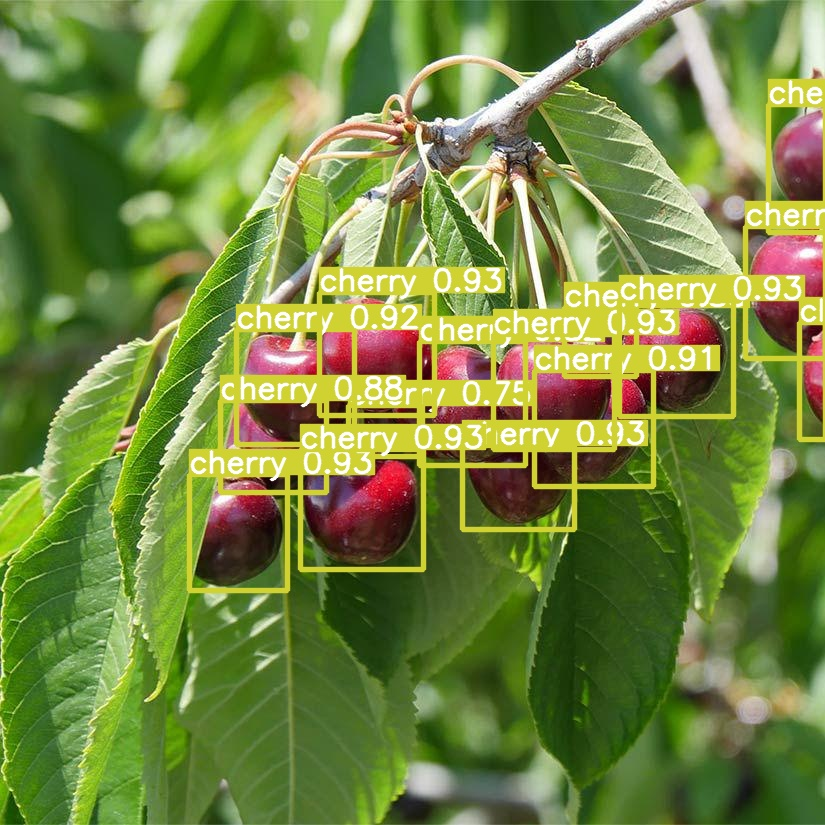

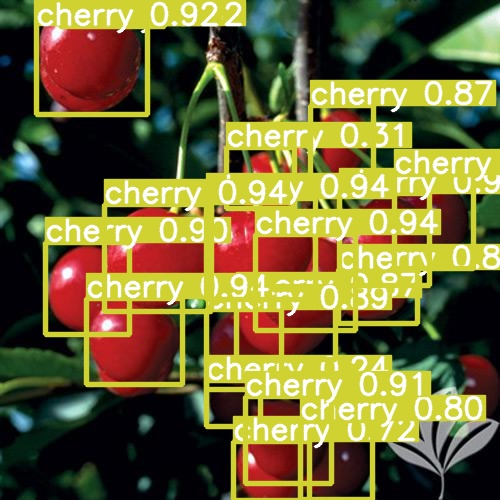

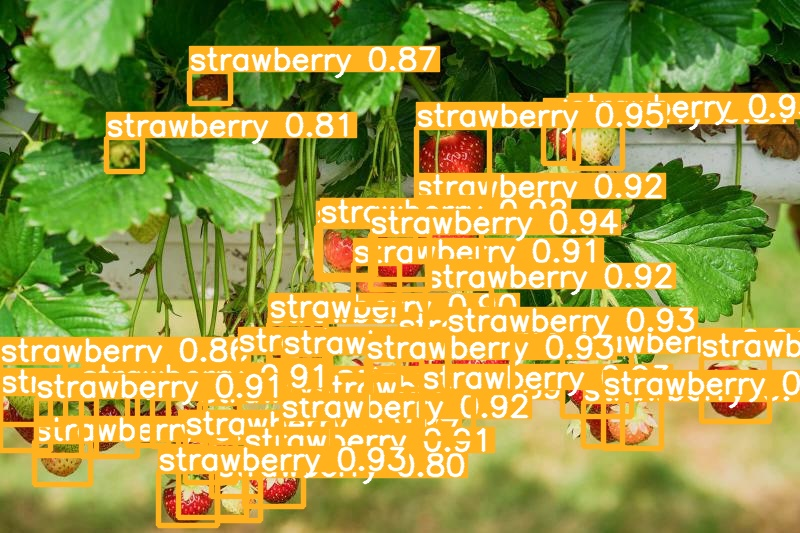

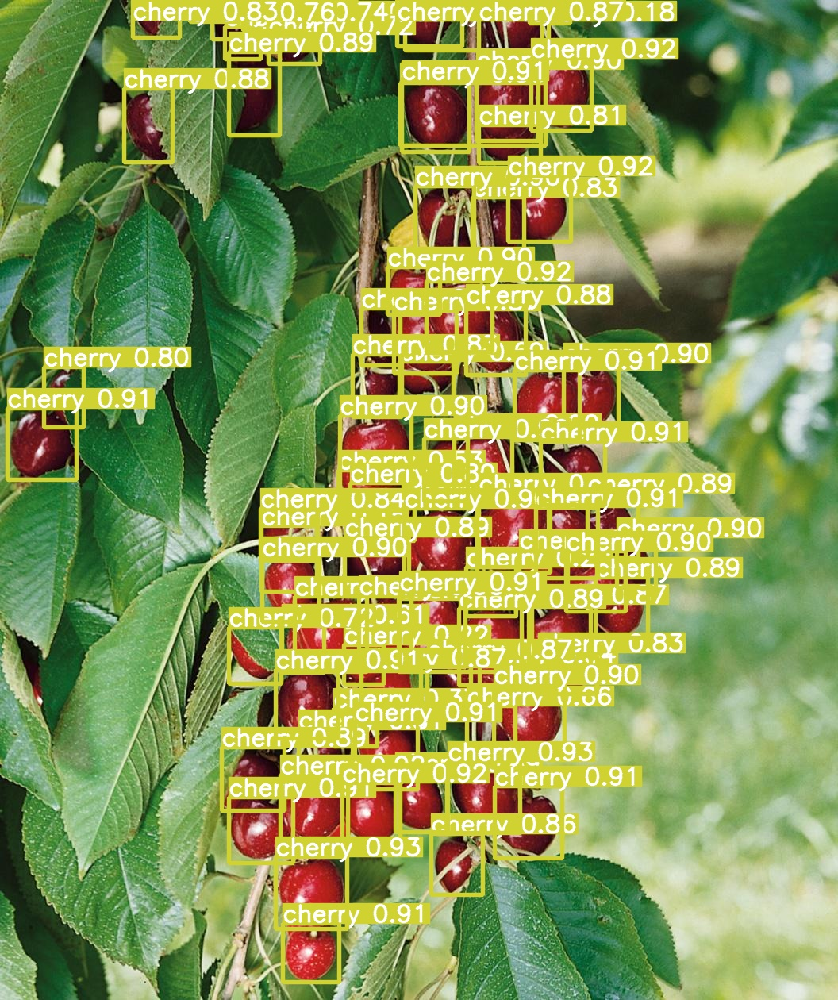

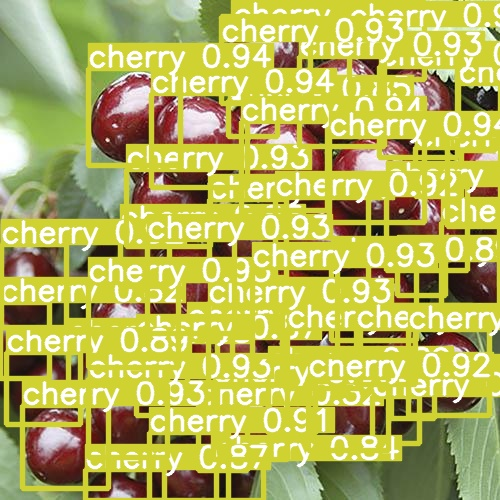

...

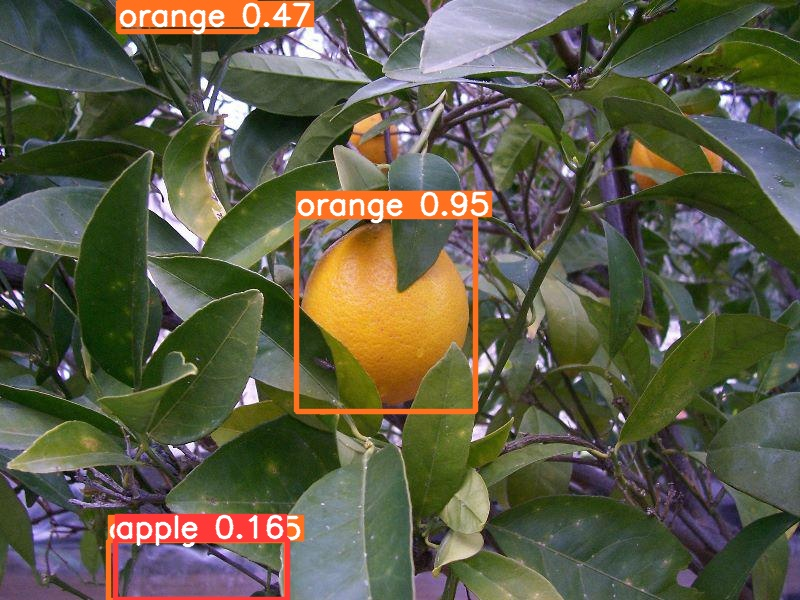

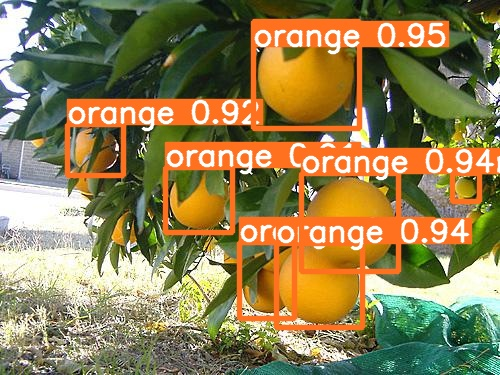

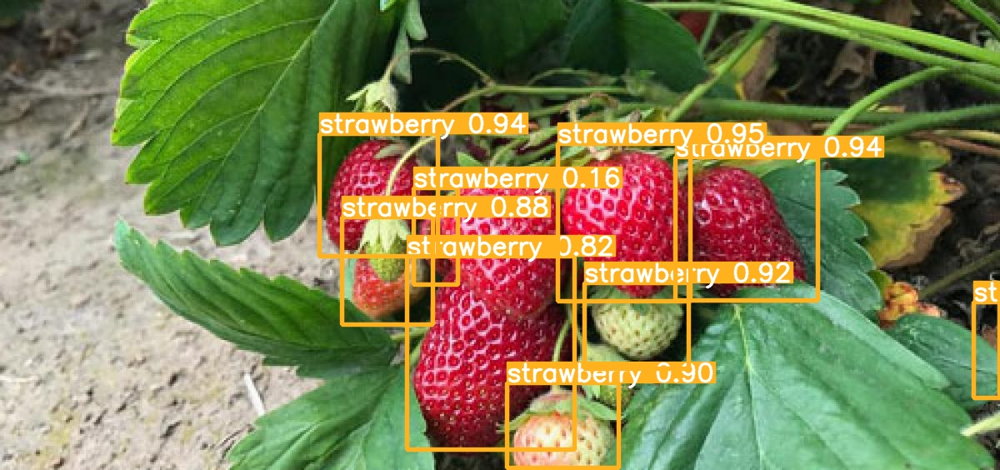

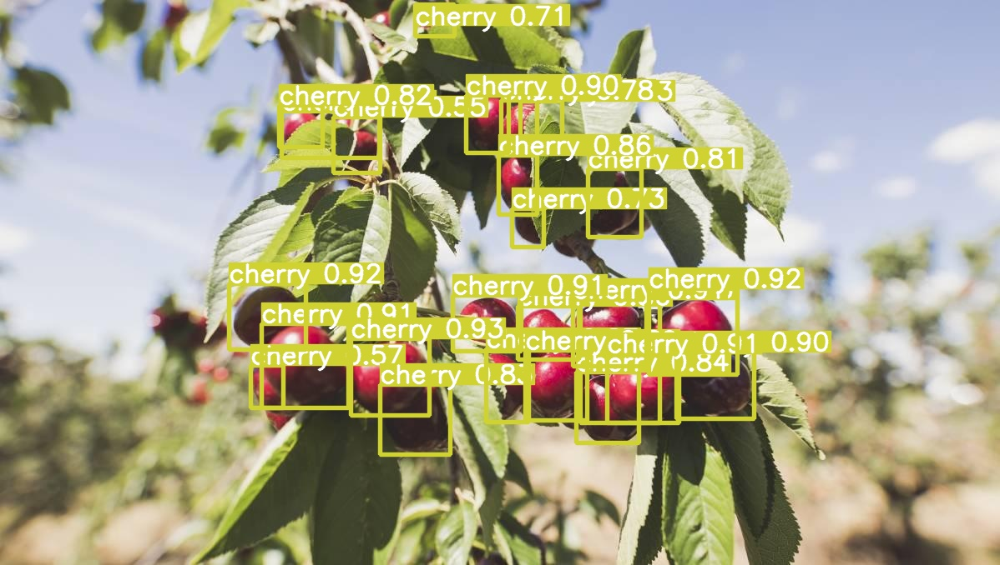

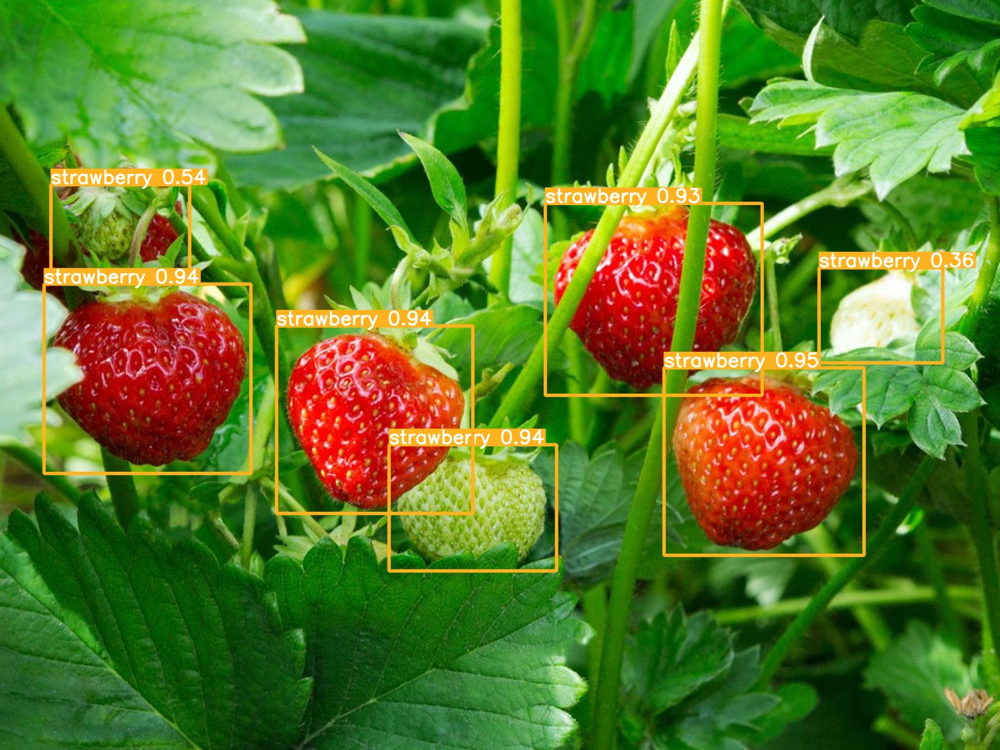

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/4IA_project/fruits/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs

In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [ ]:
! python detect.py --weights runs/train/exp2/weights/best.pt --source /content/drive/MyDrive/4IA_project/fruits/tree_farm.mp4

In [ ]:
! ls

cfg	   export.py   LICENSE.md   README.md	      test.py	    utils
data	   figure      models	    requirements.txt  tools
deploy	   hubconf.py  paper	    runs	      train_aux.py
detect.py  inference   __pycache__  scripts	      train.py


In [ ]:
os.chdir("/content")

In [ ]:
! ls

drive  final_dataset  fruits  sample_data


In [ ]:
path_to_annotations = "/content/final_dataset/labels/train/"

#Identify the path to get from the annotations to the images
path_to_images = "/content/final_dataset/images/train/"

#Import the dataset into the pylable schema
#Class names are defined here https://github.com/ultralytics/yolov5/blob/master/data/coco128.yaml
yoloclasses = ['apple','avocado','orange','strawberry', 'cherry', 'grapes']
dataset = importer.ImportYoloV5(path=path_to_annotations, path_to_images=path_to_images, cat_names=yoloclasses,
    img_ext="jpg", name="coco128")

dataset.df.head(5)

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/content/final_dataset/images/train/,CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d...,,0,416,416,3,,363.0,268.5,...,,,,,,5,grapes,,,1
1,/content/final_dataset/images/train/,CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d...,,0,416,416,3,,374.5,241.5,...,,,,,,5,grapes,,,1
2,/content/final_dataset/images/train/,CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d...,,0,416,416,3,,385.5,230.0,...,,,,,,5,grapes,,,1
3,/content/final_dataset/images/train/,CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d...,,0,416,416,3,,364.5,151.5,...,,,,,,5,grapes,,,1
4,/content/final_dataset/images/train/,CFR_1643_jpg.rf.3cc3afcb81da6f11c76b52568bc69d...,,0,416,416,3,,327.5,156.0,...,,,,,,5,grapes,,,1


In [ ]:
dataset.export.ExportToCoco(cat_id_index=1)

['/content/final_dataset/labels/train/coco128.json']

In [ ]:
path_to_annotations = "/content/final_dataset/labels/test/"

#Identify the path to get from the annotations to the images
path_to_images = "/content/final_dataset/images/test/"

#Import the dataset into the pylable schema
#Class names are defined here https://github.com/ultralytics/yolov5/blob/master/data/coco128.yaml
yoloclasses = ['apple','avocado','orange','strawberry', 'cherry', 'grapes']
dataset = importer.ImportYoloV5(path=path_to_annotations, path_to_images=path_to_images, cat_names=yoloclasses,
    img_ext="jpg", name="coco128")

dataset.df.head(5)

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/content/final_dataset/images/test/,n11706761_9001_png.rf.a6cf7cb485512f687d32ec44...,,0,291,432,3,,72.0,197.0,...,,,,,,1,avocado,,,1
1,/content/final_dataset/images/test/,n12710693_4896_png.rf.c406042ffd44864802157f82...,,1,333,500,3,,197.0,302.0,...,,,,,,2,orange,,,1
2,/content/final_dataset/images/test/,n12710693_4896_png.rf.c406042ffd44864802157f82...,,1,333,500,3,,153.0,316.0,...,,,,,,2,orange,,,1
3,/content/final_dataset/images/test/,n12710693_4896_png.rf.c406042ffd44864802157f82...,,1,333,500,3,,123.0,276.0,...,,,,,,2,orange,,,1
4,/content/final_dataset/images/test/,n12710693_4896_png.rf.c406042ffd44864802157f82...,,1,333,500,3,,143.0,225.0,...,,,,,,2,orange,,,1


In [ ]:
dataset.export.ExportToCoco(cat_id_index=1)

['/content/final_dataset/labels/test/coco128.json']

In [ ]:
path_to_annotations = "/content/final_dataset/labels/valid/"

#Identify the path to get from the annotations to the images
path_to_images = "/content/final_dataset/images/valid/"

#Import the dataset into the pylable schema
#Class names are defined here https://github.com/ultralytics/yolov5/blob/master/data/coco128.yaml
yoloclasses = ['apple','avocado','orange','strawberry', 'cherry', 'grapes']
dataset = importer.ImportYoloV5(path=path_to_annotations, path_to_images=path_to_images, cat_names=yoloclasses,
    img_ext="jpg", name="coco128")

dataset.df.head(5)

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/content/final_dataset/images/valid/,cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c...,,0,1254,836,3,,227.0,213.0,...,,,,,,4,cherry,,,1
1,/content/final_dataset/images/valid/,cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c...,,0,1254,836,3,,687.0,233.0,...,,,,,,4,cherry,,,1
2,/content/final_dataset/images/valid/,cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c...,,0,1254,836,3,,894.0,288.0,...,,,,,,4,cherry,,,1
3,/content/final_dataset/images/valid/,cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c...,,0,1254,836,3,,504.0,322.0,...,,,,,,4,cherry,,,1
4,/content/final_dataset/images/valid/,cherry-drop_jpg.rf.38698f3c369a04e447f36fe175c...,,0,1254,836,3,,565.0,347.0,...,,,,,,4,cherry,,,1


In [ ]:
dataset.export.ExportToCoco(cat_id_index=1)

['/content/final_dataset/labels/valid/coco128.json']

In [ ]:
! ls

detectron2_repo  drive	final_dataset  fruits  sample_data


In [ ]:
extract_csv('/content/drive/MyDrive/4IA_project/fruits/fruits.zip', '/content/drive/MyDrive/4IA_project/fruits/fruits')

In [ ]:
os.chdir("/content/drive/MyDrive/4IA_project/fruits/yolov5")

In [ ]:
! ls

benchmarks.py	 export.py    README.md		train.py	yolov5s.pt
classify	 hubconf.py   requirements.txt	tutorial.ipynb
CONTRIBUTING.md  LICENSE      runs		utils
data		 models       segment		val.py
detect.py	 __pycache__  setup.cfg		yolov5m.pt


In [ ]:
%pip install -qr requirements.txt

     |████████████████████████████████| 182 kB 30.5 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 


In [ ]:
import torch
import utils

In [ ]:
! pwd

/content/drive/.shortcut-targets-by-id/105tDUHODnx8OIei9Dw5mcuBbVhLQIA9X/4IA_project/fruits/yolov5


In [ ]:
with open("/content/drive/MyDrive/4IA_project/fruits/yolov5/data/data2.yaml","a") as file:
    file.write("train: /content/drive/MyDrive/4IA_project/fruits/fruits/train/images \n")
    file.write("val: /content/drive/MyDrive/4IA_project/fruits/fruits/valid/images \n")
    file.write("test: /content/drive/MyDrive/4IA_project/fruits/fruits/test/images \n")
    file.write("\n")
    file.write("is_coco: False \n")
    file.write("\n")
    file.write("nc: 6 \n")
    file.write("names: ['apple','avocado','orange','strawberry', 'cherry', 'grapes'] \n")

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data data2.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=data2.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 23 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.8.15 torch-1.13.0+cu117 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anc

In [ ]:
! python val.py --data data2.yaml --weights runs/train/exp5/weights/best.pt --task test

val: data=/content/drive/MyDrive/4IA_project/fruits/yolov5/data/data2.yaml, weights=['runs/train/exp5/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.8.15 torch-1.13.0+cu117 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/drive/MyDrive/4IA_project/fruits/fruits/test/labels... 120 images, 0 backgrounds, 0 corrupt: 100% 120/120 [00:00<00:00, 189.48it/s]
test: New cache created: /content/drive/MyDrive/4IA_project/fruits/fruits/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 4/4 [00:10<00:00,  2.71s/it]
                   all        120       1610

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data data2.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=data2.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 23 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.8.15 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anc

In [ ]:
! python val.py --data data2.yaml --weights runs/train/exp10/weights/best.pt --task test

val: data=/content/drive/MyDrive/4IA_project/fruits/yolov5/data/data2.yaml, weights=['runs/train/exp6/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.8.15 torch-1.13.0+cu117 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
test: Scanning /content/drive/MyDrive/4IA_project/fruits/fruits/test/labels.cache... 120 images, 0 backgrounds, 0 corrupt: 100% 120/120 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 4/4 [00:11<00:00,  2.93s/it]
                   all        120       1610      0.933      0.921      0.963      0.642
                 apple        120         76     

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs

In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>